In [5]:
import pandas as pd
import numpy as np
import os
from PIL import Image
import requests
from io import BytesIO
from sklearn.model_selection import train_test_split
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

BASE_DIR = os.getcwd()  # Use current working directory instead
CSV_PATH = os.path.join(BASE_DIR, "finalized_csvs")
IMAGE_PATH = os.path.join(BASE_DIR, "nrcan-2000047")


# Load your CSV data
df = os.path.join(CSV_PATH, "benthicnet_labelled.csv")
df = pd.read_csv(df)
print(f"Number of NaN values in catami_substrate: {df['catami_substrate'].isna().sum()}")
print(f"Number of non  NaN values in catami_substrate: {df['catami_substrate'].notna().sum()}")
df = df.dropna(subset=['catami_substrate'])

# Extract substrate classes and simplify if needed
print(df['catami_substrate'].unique())
df['substrate_class'] = df['catami_substrate'].apply(lambda x: x.split('>')[-1].strip())

# Create numeric labels
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df['label'] = label_encoder.fit_transform(df['substrate_class'])


/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/1064823988.py:19: DtypeWarning: Columns (3,4,11,12,14,15,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(df)


Number of NaN values in catami_substrate: 1833500
Number of non  NaN values in catami_substrate: 784516
['Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Coarse sand (with shell fragments)'
 'Substrate > Unconsolidated (soft) > Pebble / gravel > Biologenic > Coquina / shellhash'
 'Substrate > Consolidated (hard) > Rock'
 'Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Fine sand (no shell fragments)'
 'Substrate > Consolidated (hard) > Cobbles'
 'Substrate > Unconsolidated (soft) > Pebble / gravel > Pebble (10-64mm)'
 'Substrate > Unconsolidated (soft) > Pebble / gravel > Biologenic > Screwshells'
 'Substrate > Unconsolidated (soft) > Pebble / gravel > Biologenic > Coral rubble'
 'Substrate > Unconsolidated (soft) > Pebble / gravel > Biologenic'
 'Substrate > Consolidated (hard)'
 'Substrate > Consolidated (hard) > Boulders'
 'Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Mud / silt (<64um)'
 'Substrate > Unconsolidated (soft) > Pebble / gravel > Gravel (2-10m

In [6]:
df_labeled = df.dropna(subset=['catami_substrate'])
print(f"Filtered dataset size: {len(df_labeled)}")

# Now safely extract the class
df_labeled['substrate_class'] = df_labeled['catami_substrate'].apply(lambda x: x.split('>')[-1].strip())

# Create numeric labels
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df_labeled['label'] = label_encoder.fit_transform(df_labeled['substrate_class'])

# Check class distribution
class_distribution = df_labeled['substrate_class'].value_counts()
print(class_distribution)


Filtered dataset size: 784516
substrate_class
Coarse sand (with shell fragments)    249452
Sand / mud (<2mm)                     221176
Mud / silt (<64um)                    122555
Rock                                   37301
Coral rubble                           27065
Unconsolidated (soft)                  23468
Fine sand (no shell fragments)         19250
Consolidated (hard)                    16519
Coquina / shellhash                    13288
Pebble / gravel                        12935
Rhodoliths                             12153
Screwshells                             5300
Cobbles                                 4914
Boulders                                4353
Gravel (2-10mm)                         4046
Substrate                               3396
Biologenic                              1980
Tile                                    1946
Water column                            1672
Unclear                                 1009
Pebble (10-64mm)                         700
Deck     

In [10]:
def extract_dataset_source(url):
    if pd.isna(url):
        return "Unknown"

    # Extract dataset identifier from URL
    for dataset in [
        "German_Bank_2010", "Batemans", "Tasmania",
        "CatlinSeaview", "RLS", "nrcan", "pangaea"
    ]:
        if dataset.lower() in url.lower():
            return dataset

    return "Other"

df_labeled['source_dataset'] = df_labeled['url'].apply(extract_dataset_source)

# Check substrate class distribution by source
diversity_by_source = pd.crosstab(
    df_labeled['source_dataset'],
    df_labeled['simplified_class'],
    normalize='index'
)

# Calculate diversity score (higher = more evenly distributed classes)
from scipy.stats import entropy
import numpy as np

diversity_scores = {}
for dataset in diversity_by_source.index:
    # Calculate Shannon entropy as diversity measure
    class_probs = diversity_by_source.loc[dataset].values
    class_probs = class_probs[~np.isnan(class_probs)]  # Remove NaN values
    if len(class_probs) > 0:
        # Higher entropy = more diverse distribution
        dataset_entropy = entropy(class_probs)
        # Count number of classes present
        classes_present = sum(class_probs > 0)
        diversity_scores[dataset] = (dataset_entropy, classes_present)

# Sort datasets by diversity score and classes present
sorted_diversity = sorted(diversity_scores.items(),
                         key=lambda x: (x[1][1], x[1][0]),
                         reverse=True)

for dataset, (div_score, classes) in sorted_diversity[:5]:
    print(f"{dataset}: Diversity Score={div_score:.2f}, Classes={classes}")

# Get count of each substrate by dataset
substrate_counts = pd.crosstab(
    df_labeled['source_dataset'],
    df_labeled['simplified_class']
)
print("\nTop 5 most diverse datasets:")
print(substrate_counts.iloc[[diversity_by_source.index.get_loc(d[0]) for d in sorted_diversity[:5]]])


nrcan: Diversity Score=1.52, Classes=5
Other: Diversity Score=1.23, Classes=5
Tasmania: Diversity Score=0.30, Classes=5
RLS: Diversity Score=1.11, Classes=4
Batemans: Diversity Score=0.14, Classes=4

Top 5 most diverse datasets:
simplified_class  Biogenic  Gravel     Mud   Rock    Sand
source_dataset                                           
nrcan                  342     907    1146   1165     540
Other                15782    8535  119129  36457  131592
Tasmania             11468     611    1229    375  180687
RLS                   2086    6386       0   7354   21194
Batemans                86    1242       0     17   43320


/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/2082345802.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_labeled['source_dataset'] = df_labeled['url'].apply(extract_dataset_source)


In [11]:
# Filter dataset to only include nrcan records
nrcan_df = df_labeled[df_labeled['url'].str.contains('nrcan', na=False)]
print(f"Number of nrcan records: {len(nrcan_df)}")

# Analyze class distribution in this specific dataset
nrcan_class_counts = nrcan_df['simplified_class'].value_counts()
print("Class distribution in nrcan dataset:")
print(nrcan_class_counts)

# Further filter to ensure balanced classes if needed
# For example, limit to 500 samples per class (or whatever is available)
balanced_nrcan_df = pd.DataFrame()
max_samples_per_class = 500  # Adjust based on your smallest class size

for class_name in nrcan_df['simplified_class'].unique():
    class_samples = nrcan_df[nrcan_df['simplified_class'] == class_name]
    if len(class_samples) > max_samples_per_class:
        class_samples = class_samples.sample(max_samples_per_class, random_state=42)
    balanced_nrcan_df = pd.concat([balanced_nrcan_df, class_samples])

print(f"Balanced dataset size: {len(balanced_nrcan_df)}")
print(balanced_nrcan_df['simplified_class'].value_counts())

# Save this subset for future use
balanced_nrcan_df.to_csv('nrcan_balanced_subset.csv', index=False)


Number of nrcan records: 4100
Class distribution in nrcan dataset:
simplified_class
Rock        1165
Mud         1146
Gravel       907
Sand         540
Biogenic     342
Name: count, dtype: int64
Balanced dataset size: 2342
simplified_class
Rock        500
Mud         500
Gravel      500
Sand        500
Biogenic    342
Name: count, dtype: int64


In [12]:
IMAGE_PATH = os.path.join(BASE_DIR, "nrcan-2000047")
def find_image_file(image_id):
    # First try to find the image directly
    direct_path = os.path.join(IMAGE_PATH, f"{image_id}.jpg")
    if os.path.exists(direct_path):
        return direct_path

    # If not found, search through subdirectories
    for subdir in os.listdir(IMAGE_PATH):
        subdir_path = os.path.join(IMAGE_PATH, subdir)
        if os.path.isdir(subdir_path):
            img_path = os.path.join(subdir_path, f"{image_id}.jpg")
            if os.path.exists(img_path):
                return img_path


In [29]:


# List of base directories to search
base_dir = ['./nrcan-2000047', './nrcan-2013002PGC', './nrcan-2003054']

# Test the function with a sample filename
sample_url = balanced_nrcan_df['url'].iloc[0]
sample_filename = os.path.basename(sample_url)
print(f"Sample filename: {sample_filename}")
print(sample_filename)
print(f"Found at: {find_image_file(sample_filename)}")


Sample filename: 0045_4_65_full_res.png
0045_4_65_full_res.png
Found at: None


In [14]:
class_mapping = {
    'Coarse sand (with shell fragments)': 'Sand',
    'Fine sand (no shell fragments)': 'Sand',
    'Sand / mud (<2mm)': 'Sand',
    'Mud / silt (<64um)': 'Mud',
    'Rock': 'Rock',
    'Cobbles': 'Rock',
    'Boulders': 'Rock',
    'Consolidated (hard)': 'Rock',
    'Coquina / shellhash': 'Biogenic',
    'Rhodoliths': 'Biogenic',
    'Screwshells': 'Biogenic',
    'Coral rubble': 'Biogenic',
    'Biologenic': 'Biogenic',
    'Pebble / gravel': 'Gravel',
    'Gravel (2-10mm)': 'Gravel',
    'Pebble (10-64mm)': 'Gravel',
    # Drop or combine other minor classes as appropriate
}

df_labeled['simplified_class'] = df_labeled['substrate_class'].map(class_mapping)

df_labeled = df_labeled.dropna(subset=['simplified_class'])

print(df_labeled['simplified_class'].value_counts())


/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/3504649125.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_labeled['simplified_class'] = df_labeled['substrate_class'].map(class_mapping)


simplified_class
Sand        489878
Mud         122555
Rock         63087
Biogenic     59786
Gravel       17681
Name: count, dtype: int64


In [15]:
def get_image_path(row):
    """Convert URL to local path if available"""
    # Extract filename from URL
    filename = os.path.basename(row['url'])

    # Check if the file exists locally
    possible_path = os.path.join(IMAGE_PATH, filename)
    if os.path.exists(possible_path):
        return possible_path
    else:
        # Return URL if local file doesn't exist
        print("unable to find row")
        return row['url']

def find_image_file(image_id):
    # First try to find the image directly
    direct_path = os.path.join(IMAGE_PATH, f"{image_id}.jpg")
    if os.path.exists(direct_path):
        return direct_path

    # If not found, search through subdirectories
    for subdir in os.listdir(IMAGE_PATH):
        subdir_path = os.path.join(IMAGE_PATH, subdir)
        if os.path.isdir(subdir_path):
            img_path = os.path.join(subdir_path, f"{image_id}.jpg")
            if os.path.exists(img_path):
                return img_path




In [16]:
df_labeled['image_path'] = df_labeled.apply(get_image_path, axis=1)


unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to find row
unable to fi

In [15]:
print(df_labeled['image_path'].head())


0    https://s3-ap-southeast-2.amazonaws.com/imos-d...
1    https://s3-ap-southeast-2.amazonaws.com/imos-d...
2    https://s3-ap-southeast-2.amazonaws.com/imos-d...
3    https://s3-ap-southeast-2.amazonaws.com/imos-d...
4    https://s3-ap-southeast-2.amazonaws.com/imos-d...
Name: image_path, dtype: object


In [ ]:
import os
import pandas as pd
import glob

# Step 1: Create an inventory of files that actually exist in your nrcan-2000047 directory
def create_local_file_inventory(base_dir):
    """Create a set of all image filenames (without path) in the directory structure"""
    image_files = set()

    # Find all image files recursively
    for ext in ['.jpg', '.jpeg', '.png', '.tif', '.tiff']:
        for file_path in glob.glob(os.path.join(base_dir, '**', f'*{ext}'), recursive=True):
            # Add just the filename to our set
            filename = os.path.basename(file_path)
            image_files.add(filename)

    print(f"Found {len(image_files)} unique image files in {base_dir}")
    return image_files

# Step 2: Filter the dataframe to keep only rows where the image exists locally
def filter_dataframe_by_local_files(df, local_files):
    """Filter dataframe to keep only rows where image exists in local_files"""
    # Extract filename from URL
    df['filename'] = df['url'].apply(lambda x: os.path.basename(x) if pd.notna(x) else None)

    # Keep only rows where filename is in our local files
    filtered_df = df[df['filename'].isin(local_files)]

    print(f"Filtered from {len(df)} to {len(filtered_df)} rows based on available local files")
    return filtered_df

# Create inventory of local files
local_files = create_local_file_inventory('./nrcan-2000047')

# Filter the nrcan dataset
nrcan_df = df_labeled[df_labeled['url'].str.contains('nrcan-2000047', na=False)]
local_nrcan_df = filter_dataframe_by_local_files(nrcan_df, local_files)

# Check class distribution
print("\nClass distribution in local dataset:")
print(local_nrcan_df['simplified_class'].value_counts())

# Save the filtered dataset
local_nrcan_df.to_csv('nrcan_2000047_local_dataset.csv', index=False)

print("\nSaved dataset to nrcan_2000047_local_dataset.csv")


Scanning ./nrcan-2000047...
Scanning ./nrcan-2013002PGC...
Found 1062 unique image files across all directories
Found 0 total nrcan records in metadata
Filtered from 0 to 0 rows based on available local files

Class distribution in local dataset:
Series([], Name: count, dtype: int64)

Simplified class distribution:
Series([], Name: count, dtype: int64)

Saved dataset to combined_nrcan_dataset.csv

Label mapping:


In [37]:
def find_matching_files(metadata_df, base_dirs):
    """More flexible matching between metadata and local files"""
    found_matches = []

    # Create a list of all image files in the directories
    all_local_files = []
    for base_dir in base_dirs:
        for ext in ['.jpg', '.jpeg', '.png', '.tif', '.tiff']:
            all_local_files.extend(glob.glob(f'{base_dir}/**/*{ext}', recursive=True))

    print(f"Found {len(all_local_files)} local image files")

    # Create lookup dictionaries
    filename_to_path = {os.path.basename(f): f for f in all_local_files}
    basename_to_path = {os.path.splitext(os.path.basename(f))[0]: f for f in all_local_files}

    # Match each metadata entry to local files
    for idx, row in metadata_df.iterrows():
        if pd.isna(row['url']):
            continue

        url_filename = os.path.basename(row['url'])
        url_basename = os.path.splitext(url_filename)[0]

        # Try exact filename match
        if url_filename in filename_to_path:
            row_copy = row.copy()
            row_copy['local_path'] = filename_to_path[url_filename]
            found_matches.append(row_copy)
        # Try basename match (ignoring extension)
        elif url_basename in basename_to_path:
            row_copy = row.copy()
            row_copy['local_path'] = basename_to_path[url_basename]
            found_matches.append(row_copy)

    return pd.DataFrame(found_matches)

In [41]:
import os
import glob
import pandas as pd
import random
from sklearn.model_selection import train_test_split

# Step 1: Create an inventory of files
def create_file_inventory(base_dirs):
    """Create a list of all image files in the directories"""
    all_files = []

    for base_dir in base_dirs:
        print(f"Scanning {base_dir}...")
        for ext in ['.jpg', '.jpeg', '.png', '.tif', '.tiff']:
            files = glob.glob(os.path.join(base_dir, '**', f'*{ext}'), recursive=True)
            all_files.extend(files)

    print(f"Found {len(all_files)} image files")
    return all_files

# Step 2: Create a synthetic dataset based on filename patterns
def create_synthetic_dataset(image_files):
    """Create a dataset with labels derived from filename patterns"""
    data = []

    for image_path in image_files:
        filename = os.path.basename(image_path)

        # Use filename patterns to guess substrate class
        # This is a simplification - adjust based on your file naming patterns
        if any(term in filename.lower() for term in ['gravel', 'pebble']):
            substrate_class = 'Gravel'
        elif any(term in filename.lower() for term in ['rock', 'boulder', 'cobble', 'consolidated']):
            substrate_class = 'Rock'
        elif any(term in filename.lower() for term in ['mud', 'silt']):
            substrate_class = 'Mud'
        elif any(term in filename.lower() for term in ['sand']):
            substrate_class = 'Sand'
        else:
            # Assign randomly if no pattern match
            print(f"No pattern match for {filename}")
            substrate_class = random.choice(['Random', 'Random', 'Random', 'Random'])

        # Create synthetic data point
        data.append({
            'filename': filename,
            'local_path': image_path,
            'substrate_class': substrate_class,
            # Add dummy values for required fields
            'annotation_column': 0.5,
            'annotation_row': 0.5
        })

    # Create DataFrame
    df = pd.DataFrame(data)

    return df

# Step 3: Split dataset and assign labels
def prepare_dataset(df):
    """Split dataset and add numeric labels"""
    # Split into train/test
    train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['substrate_class'], random_state=42)
    train_df['partition'] = 'train'
    test_df['partition'] = 'test'
    df = pd.concat([train_df, test_df])

    # Create numeric labels
    from sklearn.preprocessing import LabelEncoder
    label_encoder = LabelEncoder()
    df['label'] = label_encoder.fit_transform(df['substrate_class'])

    # Print class distribution
    print("Class distribution:")
    print(df['substrate_class'].value_counts())

    # Print label mapping
    print("\nLabel mapping:")
    for i, class_name in enumerate(label_encoder.classes_):
        print(f"{i}: {class_name}")

    return df, label_encoder

# Main process
base_dirs = ['./nrcan-2000047', './nrcan-2013002PGC', './nrcan-2003054']
image_files = create_file_inventory(base_dirs)
synthetic_df = create_synthetic_dataset(image_files)
final_df, label_encoder = prepare_dataset(synthetic_df)

# Save the dataset
final_df.to_csv('synthetic_nrcan_dataset.csv', index=False)
print("\nSaved dataset to synthetic_nrcan_dataset.csv")

Scanning ./nrcan-2000047...
Scanning ./nrcan-2013002PGC...
Scanning ./nrcan-2003054...
Found 1896 image files
No pattern match for 0090_70_6_full_res.jpg
No pattern match for 0090_70_1_full_res.jpg
No pattern match for 0090_70_7_full_res.jpg
No pattern match for 0090_70_17_full_res.jpg
No pattern match for 0090_70_10_full_res.jpg
No pattern match for 0090_70_21_full_res.jpg
No pattern match for 0090_70_11_full_res.jpg
No pattern match for 0090_70_16_full_res.jpg
No pattern match for 0090_70_20_full_res.jpg
No pattern match for 0090_70_9_full_res.jpg
No pattern match for 0090_70_14_full_res.jpg
No pattern match for 0090_70_13_full_res.jpg
No pattern match for 0090_70_8_full_res.jpg
No pattern match for 0090_70_12_full_res.jpg
No pattern match for 0090_70_15_full_res.jpg
No pattern match for 0090_70_5_full_res.jpg
No pattern match for 0090_70_2_full_res.jpg
No pattern match for 0090_70_18_full_res.jpg
No pattern match for 0090_70_3_full_res.jpg
No pattern match for 0090_70_4_full_res.jpg

In [31]:
df = find_matching_files(df_labeled, base_dir)

Found 1896 local image files


In [32]:
print(df.head())

                                                       url source  \
2272794  http://ftp.maps.canada.ca/pub/nrcan_rncan/rast...  NRCan   
2272795  http://ftp.maps.canada.ca/pub/nrcan_rncan/rast...  NRCan   
2272927  http://ftp.maps.canada.ca/pub/nrcan_rncan/rast...  NRCan   
2272928  http://ftp.maps.canada.ca/pub/nrcan_rncan/rast...  NRCan   
2272929  http://ftp.maps.canada.ca/pub/nrcan_rncan/rast...  NRCan   

               dataset             site               image  longitude  \
2272794  nrcan-2008015  nrcan-2008015-1  0001_1_25_full_res -56.444180   
2272795  nrcan-2008015  nrcan-2008015-1  0001_1_25_full_res -56.444180   
2272927  nrcan-2008015  nrcan-2008015-5   0005_2_2_full_res -58.829181   
2272928  nrcan-2008015  nrcan-2008015-5   0005_2_3_full_res -58.829490   
2272929  nrcan-2008015  nrcan-2008015-5   0005_2_3_full_res -58.829490   

          latitude             datetime partition  annotation_column  ...  \
2272794  44.721391  2008-06-12 23:31:25     train              

Class distribution:
substrate_class
Gravel (2-10mm)                       174
Consolidated (hard)                   110
Mud / silt (<64um)                     99
Cobbles                                63
Sand / mud (<2mm)                      43
Coquina / shellhash                    29
Boulders                               23
Pebble (10-64mm)                       11
Coarse sand (with shell fragments)      2
Name: count, dtype: int64


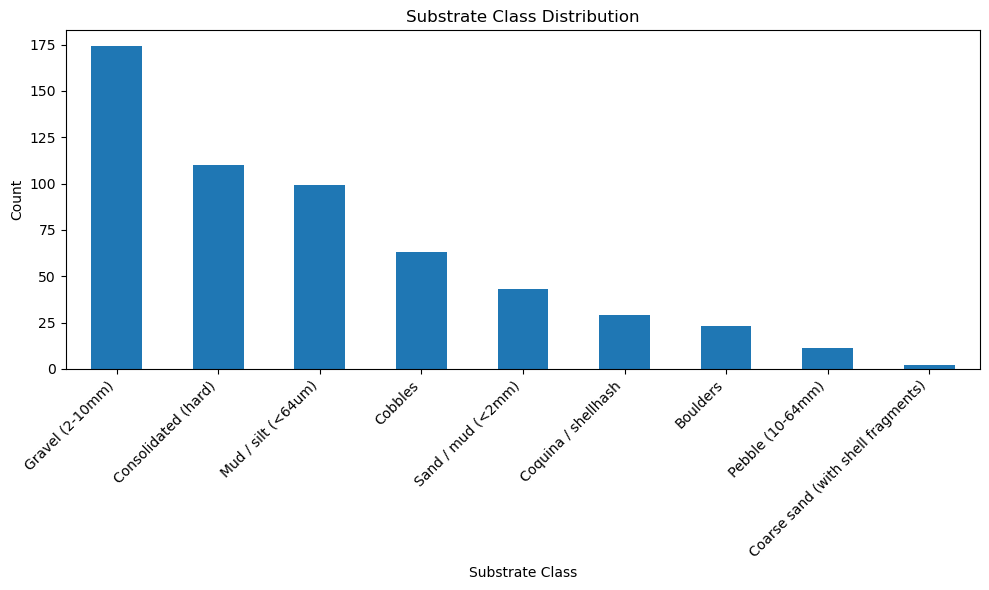

In [35]:
print("Class distribution:")
print(df['substrate_class'].value_counts())

# Visualize the distribution
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
df['substrate_class'].value_counts().plot(kind='bar')
plt.title('Substrate Class Distribution')
plt.ylabel('Count')
plt.xlabel('Substrate Class')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [93]:
import os
import glob

def find_image_file_improved(image_id, base_dirs=None):
    if base_dirs is None:
        # Use absolute paths based on your directory structure
        current_dir = '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20'
        base_dirs = [
            os.path.join(current_dir, 'nrcan-2000047'),
            os.path.join(current_dir, 'nrcan-2013002PGC'),
            os.path.join(current_dir, 'nrcan-2003054')
        ]

    # Strip any file extension from the image_id if it exists
    image_id_base = os.path.splitext(image_id)[0]

    # Try multiple potential file extensions
    extensions = ['.jpg', '.jpeg', '.png', '.tif', '.tiff']

    for base_dir in base_dirs:
        # Try to find the image with a glob pattern
        # This handles files directly in base_dir or any level of subdirectories
        for ext in extensions:
            # Try exact match first
            pattern = os.path.join(base_dir, '**', f"{image_id_base}{ext}")
            matches = glob.glob(pattern, recursive=True)

            # If found, return the first match
            if matches:
                return matches[0]

    # If the image is not found in any directory
    return None

# Now apply the improved function to your dataframe
nrcan_df['image_path'] = nrcan_df['image'].apply(lambda x: find_image_file_improved(x))

# Print some diagnostics
print(f"Total rows: {len(nrcan_df)}")
print(f"Rows with image paths: {nrcan_df['image_path'].notna().sum()}")
print(f"Missing image paths: {nrcan_df['image_path'].isna().sum()}")

# Sample a few missing images to investigate
missing_images = nrcan_df[nrcan_df['image_path'].isna()]['image'].iloc[:5].tolist()
print(f"Sample missing images: {missing_images}")

# Check directory contents for a few directories to see what's actually there
for base_dir in ['/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047']:
    print(f"\nChecking contents of a subdirectory in {base_dir}:")
    sample_subdir = os.listdir(base_dir)[0]  # Get first subdirectory
    full_subdir = os.path.join(base_dir, sample_subdir)
    if os.path.isdir(full_subdir):
        print(f"Files in {full_subdir}: {os.listdir(full_subdir)[:5]}")  # Show first 5 files

# Filter to only include rows with available local files
final_df = nrcan_df.dropna(subset=['image_path'])
print(f"Final dataset contains {len(final_df)} rows with local image files")


Total rows: 2994
Rows with image paths: 243
Missing image paths: 2751
Sample missing images: ['2121_12_10_full_res', '2121_12_10_full_res', '2121_12_10_full_res', '2121_12_10_full_res', '0219_4_1_full_res']

Checking contents of a subdirectory in /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047:
Files in /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90: ['0090_70_6_full_res.jpg', '0090_70_1_full_res.jpg', '0090_70_7_full_res.jpg', '0090_70_17_full_res.jpg', '0090_70_10_full_res.jpg']
Final dataset contains 243 rows with local image files


/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/1897835666.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nrcan_df['image_path'] = nrcan_df['image'].apply(lambda x: find_image_file_improved(x))


In [89]:
import os
import pandas as pd
import glob

# Step 1: Load the full labeled dataset
CSV_PATH = os.path.join(BASE_DIR, "finalized_csvs")
csv_file = os.path.join(CSV_PATH, "benthicnet_labelled.csv")
df_full = pd.read_csv(csv_file)
print(f"Loaded full dataset with {len(df_full)} rows")

# Step 2: Define specific patterns for the most distinguishable classes
sand_mud_pattern = 'Sand / mud \(<1mm\)|Sand / mud \(<2mm\)'  # Sand/mud class
rock_pattern = '> Rock|> rock'  # Rock class (with '>' to avoid matching other terms)
silt_mud_pattern = 'Mud / silt|Silt / mud|silt \(<|Mud \(<'  # Silt/mud class

# Filter rows
sand_mud_rows = df_full[df_full['catami_substrate'].str.contains(sand_mud_pattern, na=False, regex=True)]
rock_rows = df_full[df_full['catami_substrate'].str.contains(rock_pattern, na=False, regex=True)]
silt_mud_rows = df_full[df_full['catami_substrate'].str.contains(silt_mud_pattern, na=False, regex=True)]

print(f"Found {len(sand_mud_rows)} sand/mud rows")
print(f"Found {len(rock_rows)} rock rows")
print(f"Found {len(silt_mud_rows)} silt/mud rows")

# Print sample values to verify correct filtering
print("\nSand/mud substrate types (sample):")
print(sand_mud_rows['catami_substrate'].unique()[:5])  # Show first 5

print("\nRock substrate types (sample):")
print(rock_rows['catami_substrate'].unique()[:5])

print("\nSilt/mud substrate types (sample):")
print(silt_mud_rows['catami_substrate'].unique()[:5])

# Combine the filtered rows
multi_class_df = pd.concat([sand_mud_rows, rock_rows, silt_mud_rows])

# Step 3: Create a class column
multi_class_df['substrate_class'] = 'Unknown'
multi_class_df.loc[multi_class_df['catami_substrate'].str.contains(sand_mud_pattern, na=False, regex=True), 'substrate_class'] = 'Sand/mud'
multi_class_df.loc[multi_class_df['catami_substrate'].str.contains(rock_pattern, na=False, regex=True), 'substrate_class'] = 'Rock'
multi_class_df.loc[multi_class_df['catami_substrate'].str.contains(silt_mud_pattern, na=False, regex=True), 'substrate_class'] = 'Silt/mud'

# Step 4: Filter to only include nrcan dataset rows
nrcan_df = multi_class_df[multi_class_df['url'].str.contains('nrcan', na=False)]
print(f"Found {len(nrcan_df)} nrcan rows with the selected classes")



/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/2092034410.py:8: DtypeWarning: Columns (3,4,11,12,14,15,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  df_full = pd.read_csv(csv_file)


Loaded full dataset with 2618016 rows
Found 612433 sand/mud rows
Found 37301 rock rows
Found 122555 silt/mud rows

Sand/mud substrate types (sample):
['Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Coarse sand (with shell fragments)'
 'Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Fine sand (no shell fragments)'
 'Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Mud / silt (<64um)'
 'Substrate > Unconsolidated (soft) > Sand / mud (<2mm)']

Rock substrate types (sample):
['Substrate > Consolidated (hard) > Rock']

Silt/mud substrate types (sample):
['Substrate > Unconsolidated (soft) > Sand / mud (<2mm) > Mud / silt (<64um)']
Found 2994 nrcan rows with the selected classes


In [ ]:
print(nrcan_df["image"].iloc[:10])

2272767    2121_12_10_full_res
2272768    2121_12_10_full_res
2272769    2121_12_10_full_res
2272770    2121_12_10_full_res
2272776      0219_4_1_full_res
2272777      0219_4_1_full_res
2272778      0219_4_1_full_res
2272779      0219_4_1_full_res
2272780      9872_1_2_full_res
2272781      9872_1_2_full_res
Name: image, dtype: object


In [91]:
nrcan_df['image_path'] = nrcan_df['image'].apply(lambda x: find_image_file(x))
final_df = nrcan_df.dropna(subset=['image_path'])
print(f"Final dataset contains {len(final_df)} rows with local image files")


Final dataset contains 243 rows with local image files


/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/2226946665.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nrcan_df['image_path'] = nrcan_df['image'].apply(lambda x: find_image_file(x))


In [92]:
import os
import glob
import pandas as pd

def create_complete_image_inventory(base_dirs):
    """Create a comprehensive mapping of all image files in the directories"""
    # Dictionary to store filename -> path mappings
    image_inventory = {}

    # Find all image files in all directories
    for base_dir in base_dirs:
        print(f"Scanning {base_dir} for image files...")

        # Use glob to find all image files recursively
        for ext in ['.jpg', '.jpeg', '.png', '.tif', '.tiff']:
            pattern = os.path.join(base_dir, '**', f"*{ext}")
            for file_path in glob.glob(pattern, recursive=True):
                # Get the filename without extension
                filename = os.path.basename(file_path)
                basename = os.path.splitext(filename)[0]

                # Store mappings for both with and without extension
                image_inventory[filename] = file_path
                image_inventory[basename] = file_path

    print(f"Found {len(image_inventory)} unique filenames")
    return image_inventory

# Create inventory
current_dir = '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20'
base_dirs = [
    os.path.join(current_dir, 'nrcan-2000047'),
    os.path.join(current_dir, 'nrcan-2013002PGC'),
    os.path.join(current_dir, 'nrcan-2003054')
]
image_inventory = create_complete_image_inventory(base_dirs)

# Now use this inventory to match with your dataset
def match_with_inventory(image_name, inventory):
    # Try with original name
    if image_name in inventory:
        return inventory[image_name]

    # Try without extension
    basename = os.path.splitext(image_name)[0]
    if basename in inventory:
        return inventory[basename]

    return None

# Apply to your dataframe
nrcan_df['image_path'] = nrcan_df['image'].apply(lambda x: match_with_inventory(x, image_inventory))

# Filter to only include rows with available local files
final_df = nrcan_df.dropna(subset=['image_path'])
print(f"Final dataset contains {len(final_df)} rows with local image files")


Scanning /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047 for image files...
Scanning /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2013002PGC for image files...
Scanning /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2003054 for image files...
Found 3762 unique filenames
Final dataset contains 243 rows with local image files


/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/1873160060.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nrcan_df['image_path'] = nrcan_df['image'].apply(lambda x: match_with_inventory(x, image_inventory))


In [115]:

def create_complete_image_inventory(base_dirs):
    """Create a comprehensive mapping of all image files in the directories"""
    # Dictionary to store filename -> path mappings
    image_inventory = {}

    # Find all image files in all directories
    for base_dir in base_dirs:
        print(f"Scanning {base_dir} for image files...")

        # Use glob to find all image files recursively
        for ext in ['.jpg', '.jpeg', '.png', '.tif', '.tiff']:
            pattern = os.path.join(base_dir, '**', f"*{ext}")
            for file_path in glob.glob(pattern, recursive=True):
                # Get the filename without extension
                filename = os.path.basename(file_path)
                basename = os.path.splitext(filename)[0]

                # Store mappings for both with and without extension
                image_inventory[basename] = file_path

    print(f"Found {len(image_inventory)} unique filenames")
    return image_inventory
create_complete_image_inventory(base_dirs)


Scanning /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047 for image files...
Scanning /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2013002PGC for image files...
Scanning /Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2003054 for image files...
Found 1881 unique filenames


{'0090_70_6_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/0090_70_6_full_res.jpg',
 '0090_70_1_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/0090_70_1_full_res.jpg',
 '0090_70_7_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/0090_70_7_full_res.jpg',
 '0090_70_17_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/0090_70_17_full_res.jpg',
 '0090_70_10_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/0090_70_10_full_res.jpg',
 '0090_70_21_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/0090_70_21_full_res.jpg',
 '0090_70_11_full_res': '/Users/naeemujeeb/developement/MartimeHabitatPrediction/nrcan-20/nrcan-2000047/nrcan-2000047-90/009

In [128]:
nrcan_df = df_labeled[df_labeled['url'].str.contains('nrcan', na=False)]
final_df = pd.DataFrame()
for index, row in nrcan_df.iterrows():
    if row['image'] in image_inventory:
        # Convert the row to a DataFrame and then concatenate
        row_df = pd.DataFrame([row])
        final_df = pd.concat([final_df, row_df], ignore_index=True)

# final_df.to_csv('nrcan_dataset.csv', index=False)
print(len(final_df))

# save final_df to csv
final_df.to_csv('nrcan_dataset.csv', index=False)

554


In [130]:
#find catami_subtrate distribution
print(final_df['substrate_class'].value_counts())

substrate_class
Gravel (2-10mm)                       174
Consolidated (hard)                   110
Mud / silt (<64um)                     99
Cobbles                                63
Sand / mud (<2mm)                      43
Coquina / shellhash                    29
Boulders                               23
Pebble (10-64mm)                       11
Coarse sand (with shell fragments)      2
Name: count, dtype: int64


In [131]:
# Filter for just the two classes you want
binary_df = final_df[final_df['catami_substrate'].str.contains('Gravel \(2-10mm\)|Consolidated \(hard\)')]

# Create binary labels
binary_df['label'] = (binary_df['catami_substrate'].str.contains('Gravel \(2-10mm\)')).astype(int)

# Balance the dataset
gravel_samples = binary_df[binary_df['label'] == 1]
consolidated_samples = binary_df[binary_df['label'] == 0]

# Take the smaller size to ensure balance
sample_size = min(len(gravel_samples), len(consolidated_samples))
balanced_gravel = gravel_samples.sample(sample_size, random_state=42)
balanced_consolidated = consolidated_samples.sample(sample_size, random_state=42)

# Combine and shuffle
balanced_df = pd.concat([balanced_gravel, balanced_consolidated])
balanced_df = balanced_df.sample(frac=1, random_state=42).reset_index(drop=True)



/var/folders/xt/7xy447n95498cjtg_n01cgtm0000gn/T/ipykernel_31559/2577652516.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  binary_df['label'] = (binary_df['catami_substrate'].str.contains('Gravel \(2-10mm\)')).astype(int)


In [132]:
from sklearn.model_selection import train_test_split

# Split into train (70%), validation (15%), and test (15%)
train_df, temp_df = train_test_split(balanced_df, test_size=0.3, stratify=balanced_df['label'], random_state=42)
val_df, test_df = train_test_split(temp_df, test_size=0.5, stratify=temp_df['label'], random_state=42)

In [133]:
class SubstrateDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        img_name = self.dataframe.iloc[idx]['image']
        img_path = find_image_file(img_name)

        if img_path is None:
            raise FileNotFoundError(f"Could not find image file for {img_name}")

        image = Image.open(img_path).convert('RGB')
        label = self.dataframe.iloc[idx]['label']

        if self.transform:
            image = self.transform(image)

        return image, label

In [135]:
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

val_test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = SubstrateDataset(train_df, transform=train_transform)
val_dataset = SubstrateDataset(val_df, transform=val_test_transform)
test_dataset = SubstrateDataset(test_df, transform=val_test_transform)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16)
test_loader = DataLoader(test_dataset, batch_size=16)



In [136]:
import torch.nn as nn
import torchvision.models as models

# Set up device
device = torch.device("mps" if torch.backends.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu")

# Create model
def create_model(num_classes=2):
    model = models.resnet50(weights='IMAGENET1K_V2')

    # Freeze early layers
    for param in list(model.parameters())[:-20]:
        param.requires_grad = False

    # Replace final layer
    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, num_classes)

    return model

# Create and move model to device
model = create_model().to(device)



In [137]:
import torch.optim as optim
from tqdm import tqdm

# Set up training components
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

# Training loop
num_epochs = 10
best_val_loss = float('inf')

for epoch in range(num_epochs):
    # Train
    model.train()
    train_loss = 0
    correct = 0
    total = 0

    for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
        inputs, labels = inputs.to(device), labels.to(device)

        # Zero gradients
        optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        # Statistics
        train_loss += loss.item() * inputs.size(0)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = train_loss / total
    train_acc = 100 * correct / total

    # Validate
    model.eval()
    val_loss = 0
    correct = 0
    total = 0

    with torch.no_grad():
        for inputs, labels in tqdm(val_loader, desc="Validating"):
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            val_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    val_loss = val_loss / total
    val_acc = 100 * correct / total

    # Print statistics
    print(f"Epoch {epoch+1}/{num_epochs}:")
    print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")
    print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%")

    # Learning rate scheduler
    scheduler.step(val_loss)

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), 'best_substrate_model.pth')
        print("Model saved!")



/opt/anaconda3/envs/benthnet/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Validating: 100%|██████████| 4/4 [00:04<00:00,  1.05s/it]


Epoch 1/10:
Train Loss: 0.6370, Train Acc: 70.78%
Val Loss: 0.6298, Val Acc: 75.00%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.93it/s]


Epoch 2/10:
Train Loss: 0.5033, Train Acc: 81.48%
Val Loss: 0.3694, Val Acc: 90.38%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.82it/s]


Epoch 3/10:
Train Loss: 0.3782, Train Acc: 85.60%
Val Loss: 0.2707, Val Acc: 88.46%
Model saved!


Validating: 100%|██████████| 4/4 [00:00<00:00,  4.03it/s]


Epoch 4/10:
Train Loss: 0.2615, Train Acc: 93.83%
Val Loss: 0.2088, Val Acc: 86.54%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.96it/s]


Epoch 5/10:
Train Loss: 0.1920, Train Acc: 93.00%
Val Loss: 0.1768, Val Acc: 96.15%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.95it/s]


Epoch 6/10:
Train Loss: 0.1554, Train Acc: 93.42%
Val Loss: 0.1706, Val Acc: 94.23%
Model saved!


Validating: 100%|██████████| 4/4 [00:00<00:00,  4.03it/s]


Epoch 7/10:
Train Loss: 0.1550, Train Acc: 96.30%
Val Loss: 0.1693, Val Acc: 94.23%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.88it/s]


Epoch 8/10:
Train Loss: 0.1115, Train Acc: 97.53%
Val Loss: 0.1664, Val Acc: 92.31%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.97it/s]


Epoch 9/10:
Train Loss: 0.1098, Train Acc: 96.71%
Val Loss: 0.1395, Val Acc: 94.23%
Model saved!


Validating: 100%|██████████| 4/4 [00:01<00:00,  3.96it/s]


Epoch 10/10:
Train Loss: 0.0796, Train Acc: 98.35%
Val Loss: 0.1277, Val Acc: 96.15%
Model saved!



Classification Report:
                     precision    recall  f1-score   support

Consolidated (hard)       0.88      0.85      0.87        27
    Gravel (2-10mm)       0.85      0.88      0.87        26

           accuracy                           0.87        53
          macro avg       0.87      0.87      0.87        53
       weighted avg       0.87      0.87      0.87        53



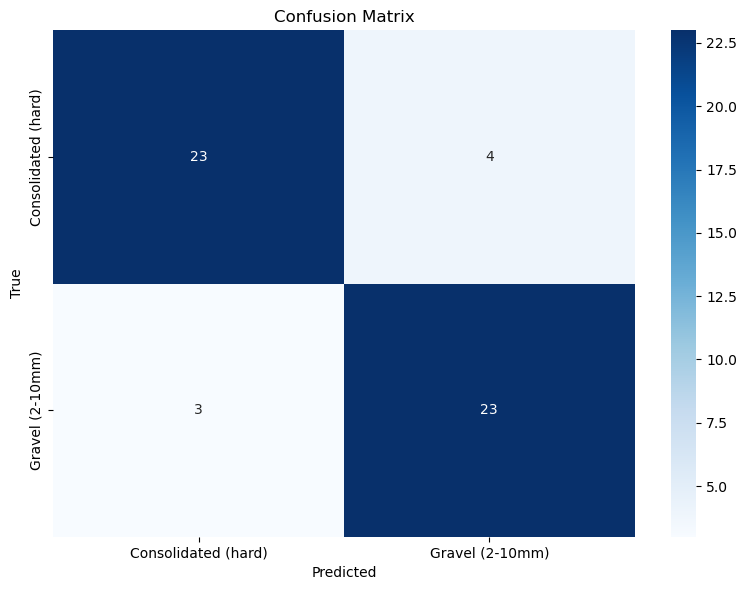

In [138]:
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load best model
model.load_state_dict(torch.load('best_substrate_model.pth'))

# Evaluate on test set
model.eval()
y_true = []
y_pred = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, predicted = torch.max(outputs, 1)

        y_true.extend(labels.cpu().numpy())
        y_pred.extend(predicted.cpu().numpy())

# Convert to numpy arrays
y_true = np.array(y_true)
y_pred = np.array(y_pred)

# Print classification report
print("\nClassification Report:")
print(classification_report(y_true, y_pred, target_names=['Consolidated (hard)', 'Gravel (2-10mm)']))

# Create confusion matrix
cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
           xticklabels=['Consolidated (hard)', 'Gravel (2-10mm)'],
           yticklabels=['Consolidated (hard)', 'Gravel (2-10mm)'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.tight_layout()
plt.show()




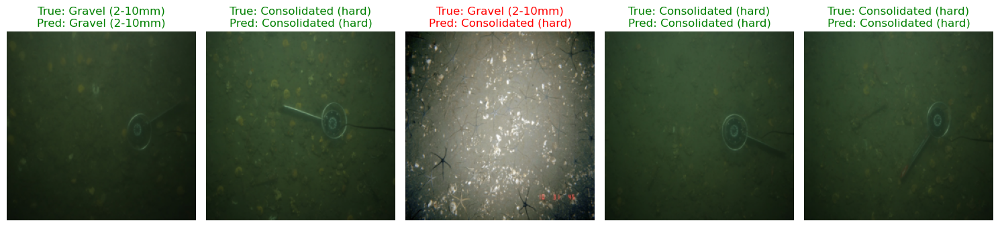

In [139]:
def visualize_predictions(model, test_loader, num_samples=5):
    """
    Visualize example test images with their true and predicted classifications
    """
    # Get batch of test images
    dataiter = iter(test_loader)
    images, labels = next(dataiter)

    # Get predictions
    model.eval()
    with torch.no_grad():
        outputs = model(images.to(device))
        _, preds = torch.max(outputs, 1)

    # Convert to numpy for visualization
    images = images.cpu().numpy()
    labels = labels.cpu().numpy()
    preds = preds.cpu().numpy()

    # Class names for readability
    class_names = ['Consolidated (hard)', 'Gravel (2-10mm)']

    # Plot images with labels
    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))

    for i in range(num_samples):
        # Convert image from tensor to displayable format
        img = np.transpose(images[i], (1, 2, 0))
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = np.clip(img, 0, 1)

        # Display image and labels
        axes[i].imshow(img)
        title_color = 'green' if preds[i] == labels[i] else 'red'
        axes[i].set_title(f"True: {class_names[labels[i]]}\nPred: {class_names[preds[i]]}",
                          color=title_color)
        axes[i].axis('off')

    plt.tight_layout()
    plt.savefig("substrate_predictions.png")
    plt.show()

# Call the function to visualize example predictions
visualize_predictions(model, test_loader)


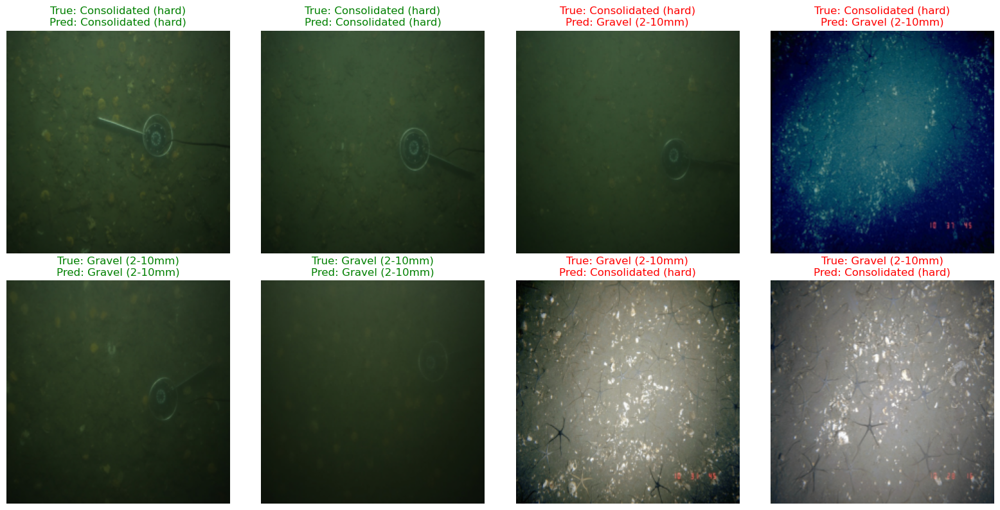

In [140]:
def show_class_examples(model, test_loader, class_names=['Consolidated (hard)', 'Gravel (2-10mm)']):
    """
    Show examples of correct and incorrect predictions for each class
    """
    # Collect examples
    correct_examples = [[] for _ in range(len(class_names))]
    incorrect_examples = [[] for _ in range(len(class_names))]

    model.eval()
    with torch.no_grad():
        for images, labels in test_loader:
            outputs = model(images.to(device))
            _, preds = torch.max(outputs, 1)

            # Convert to numpy
            images_np = images.cpu().numpy()
            labels_np = labels.cpu().numpy()
            preds_np = preds.cpu().numpy()

            for i in range(len(labels_np)):
                true_class = labels_np[i]

                # Store the example in the appropriate list
                if preds_np[i] == true_class:
                    correct_examples[true_class].append((images_np[i], true_class, preds_np[i]))
                else:
                    incorrect_examples[true_class].append((images_np[i], true_class, preds_np[i]))

                # Break if we have enough examples
                enough_examples = all([len(examples) >= 2 for examples in correct_examples]) and \
                                  all([len(examples) >= 2 for examples in incorrect_examples])
                if enough_examples:
                    break

    # Create visualization
    fig, axes = plt.subplots(len(class_names), 4, figsize=(16, 8))

    for class_idx in range(len(class_names)):
        # Correct examples (up to 2)
        for i in range(min(2, len(correct_examples[class_idx]))):
            img, true_class, pred_class = correct_examples[class_idx][i]
            img = np.transpose(img, (1, 2, 0))
            img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
            img = np.clip(img, 0, 1)

            axes[class_idx, i].imshow(img)
            axes[class_idx, i].set_title(f"True: {class_names[true_class]}\nPred: {class_names[pred_class]}",
                                          color='green')
            axes[class_idx, i].axis('off')

        # Incorrect examples (up to 2)
        for i in range(min(2, len(incorrect_examples[class_idx]))):
            img, true_class, pred_class = incorrect_examples[class_idx][i]
            img = np.transpose(img, (1, 2, 0))
            img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
            img = np.clip(img, 0, 1)

            axes[class_idx, i+2].imshow(img)
            axes[class_idx, i+2].set_title(f"True: {class_names[true_class]}\nPred: {class_names[pred_class]}",
                                          color='red')
            axes[class_idx, i+2].axis('off')

    plt.tight_layout()
    plt.savefig("substrate_class_examples.png")
    plt.show()

# Call the function to visualize examples for each class
show_class_examples(model, test_loader)


Testing: LR=0.01, BS=8, Freeze=10
Validation Accuracy: 94.23%
Testing: LR=0.01, BS=8, Freeze=20
Validation Accuracy: 92.31%
Testing: LR=0.01, BS=8, Freeze=50
Validation Accuracy: 88.46%
Testing: LR=0.01, BS=16, Freeze=10
Validation Accuracy: 84.62%
Testing: LR=0.01, BS=16, Freeze=20
Validation Accuracy: 94.23%
Testing: LR=0.01, BS=16, Freeze=50
Validation Accuracy: 92.31%
Testing: LR=0.01, BS=32, Freeze=10
Validation Accuracy: 94.23%
Testing: LR=0.01, BS=32, Freeze=20
Validation Accuracy: 88.46%
Testing: LR=0.01, BS=32, Freeze=50
Validation Accuracy: 86.54%
Testing: LR=0.001, BS=8, Freeze=10
Validation Accuracy: 92.31%
Testing: LR=0.001, BS=8, Freeze=20
Validation Accuracy: 96.15%
Testing: LR=0.001, BS=8, Freeze=50
Validation Accuracy: 94.23%
Testing: LR=0.001, BS=16, Freeze=10
Validation Accuracy: 90.38%
Testing: LR=0.001, BS=16, Freeze=20
Validation Accuracy: 94.23%
Testing: LR=0.001, BS=16, Freeze=50
Validation Accuracy: 88.46%
Testing: LR=0.001, BS=32, Freeze=10
Validation Accuracy

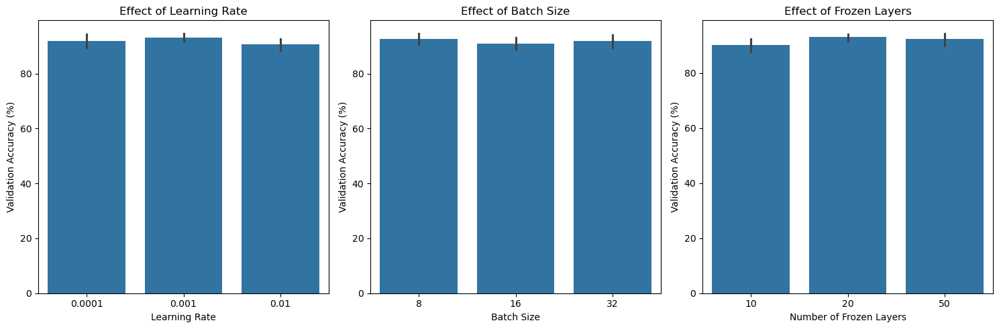

In [142]:
def train_with_params(learning_rate, batch_size, freeze_layers):
    """Train model with different hyperparameters and return validation accuracy"""
    # Create new model
    model = models.resnet50(weights='IMAGENET1K_V2')

    # Freeze layers according to parameter
    for param in list(model.parameters())[:-freeze_layers]:
        param.requires_grad = False

    # Replace final layer
    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, 2)
    model = model.to(device)

    # Create dataloaders with specified batch size
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    # Set up optimizer with specified learning rate
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    criterion = nn.CrossEntropyLoss()

    # Train for 5 epochs
    for epoch in range(5):
        # Train
        model.train()
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

        # Validate
        model.eval()
        correct = 0
        total = 0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

        val_acc = 100 * correct / total

    return val_acc

# Test different hyperparameter combinations
results = []
learning_rates = [0.01, 0.001, 0.0001]
batch_sizes = [8, 16, 32]
freeze_layers = [10, 20, 50]

for lr in learning_rates:
    for bs in batch_sizes:
        for fl in freeze_layers:
            print(f"Testing: LR={lr}, BS={bs}, Freeze={fl}")
            val_acc = train_with_params(lr, bs, fl)
            results.append({
                'learning_rate': lr,
                'batch_size': bs,
                'freeze_layers': fl,
                'val_accuracy': val_acc
            })
            print(f"Validation Accuracy: {val_acc:.2f}%")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
print(results_df.sort_values('val_accuracy', ascending=False).head())

# Visualize hyperparameter effects
plt.figure(figsize=(15, 5))

# Learning rate effect
plt.subplot(1, 3, 1)
sns.barplot(x='learning_rate', y='val_accuracy', data=results_df)
plt.title('Effect of Learning Rate')
plt.xlabel('Learning Rate')
plt.ylabel('Validation Accuracy (%)')

# Batch size effect
plt.subplot(1, 3, 2)
sns.barplot(x='batch_size', y='val_accuracy', data=results_df)
plt.title('Effect of Batch Size')
plt.xlabel('Batch Size')
plt.ylabel('Validation Accuracy (%)')

# Freeze layers effect
plt.subplot(1, 3, 3)
sns.barplot(x='freeze_layers', y='val_accuracy', data=results_df)
plt.title('Effect of Frozen Layers')
plt.xlabel('Number of Frozen Layers')
plt.ylabel('Validation Accuracy (%)')

plt.tight_layout()
plt.savefig('hyperparameter_effects.png')
plt.show()
